### Листинг 1.2 Поиск окружностей в пространстве Хафа

In [1]:
import cv2
import os
import skimage.draw
import skimage.transform
import skimage.morphology
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
import warnings
warnings.filterwarnings('ignore')
export_parallel = True
use_graph = True

In [2]:
# Исходные изображения с окружностями
images = [cv2.cvtColor(cv2.imread(f"data/circles/{image_path}"), cv2.COLOR_BGR2GRAY) for image_path in os.listdir("data/circles")]

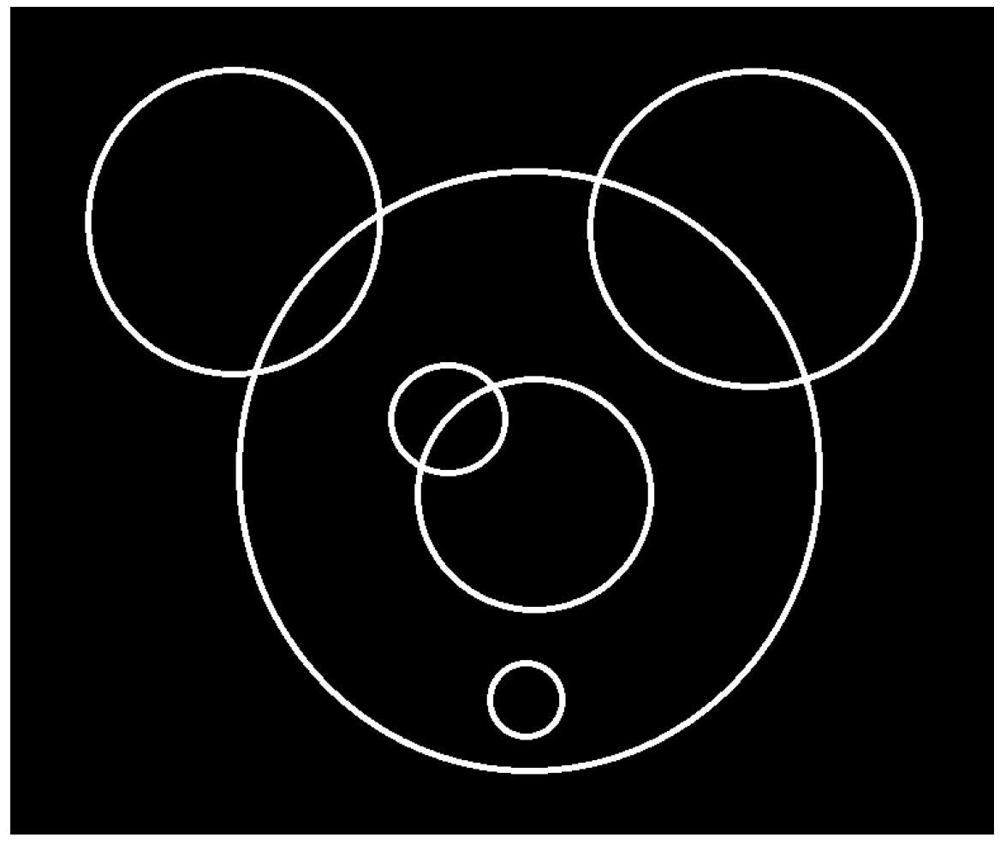

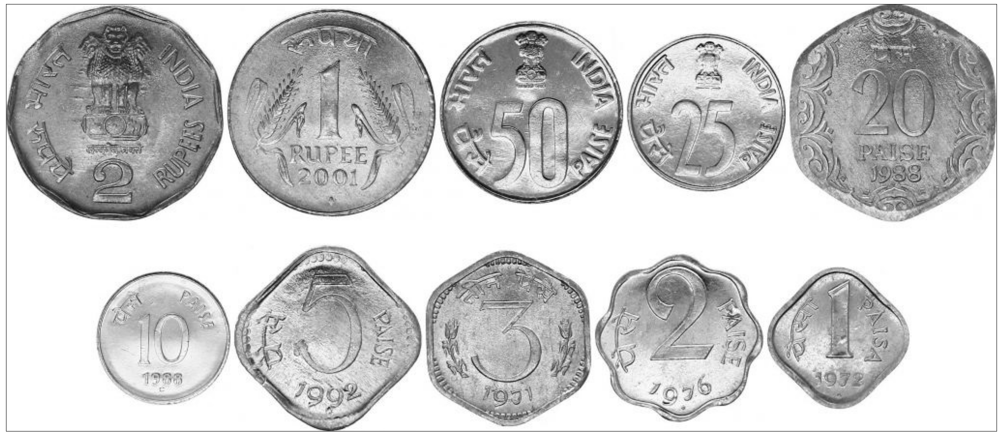

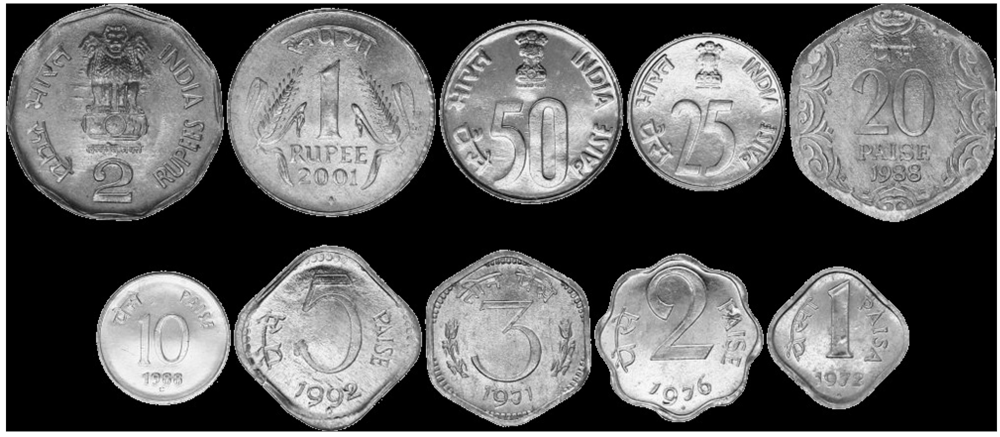

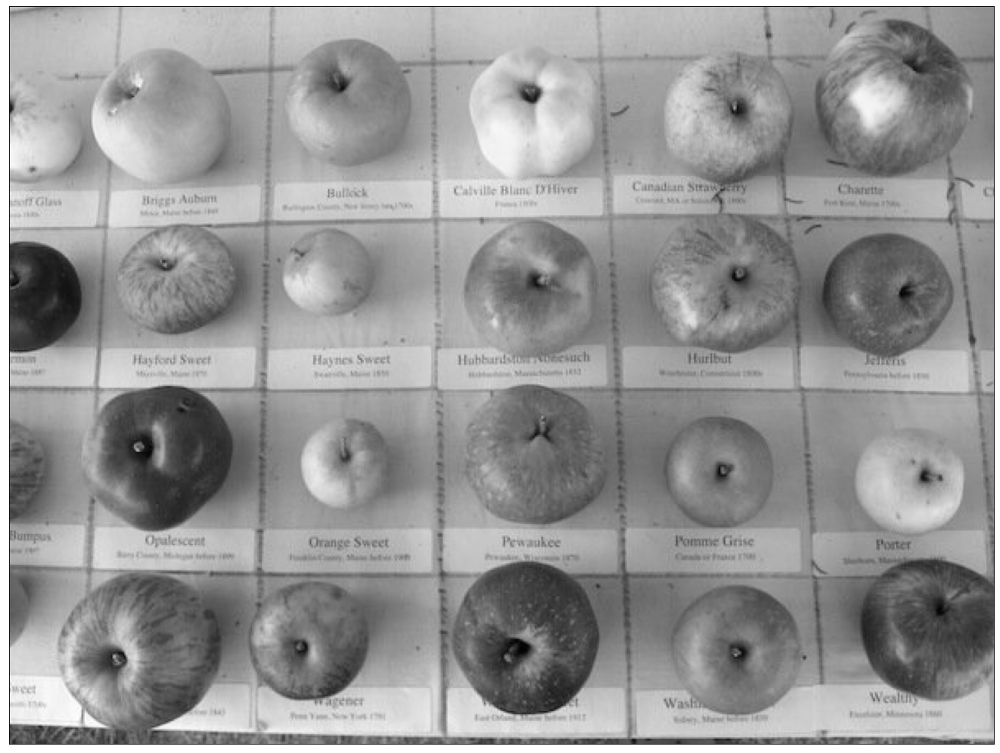

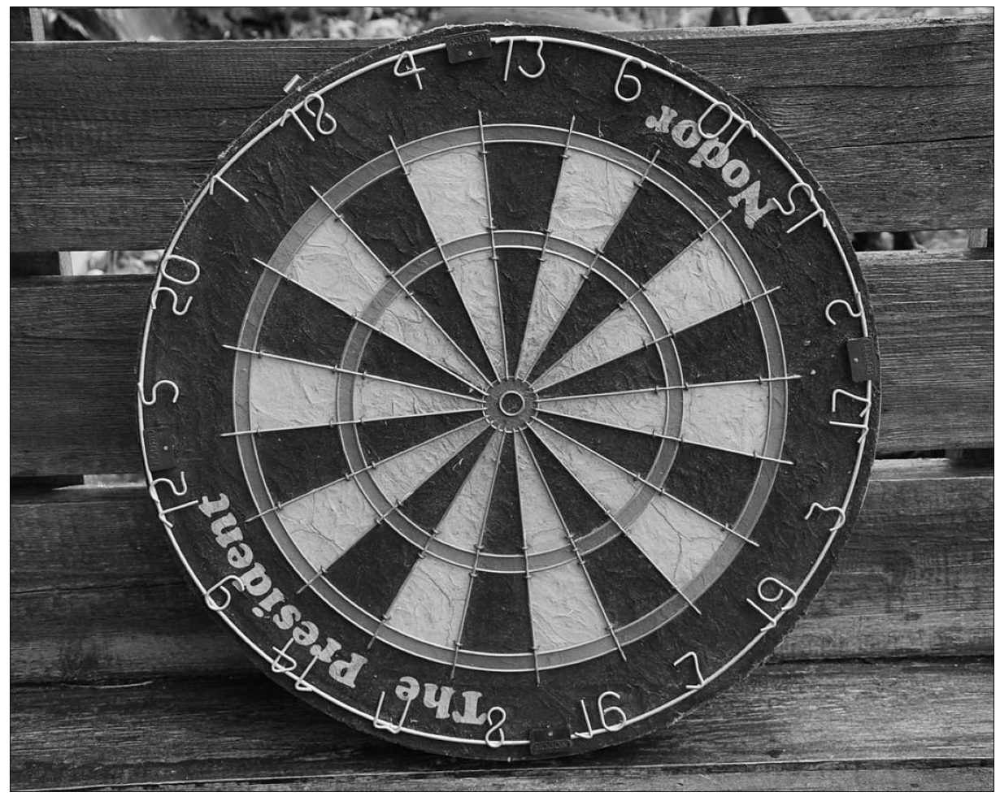

In [3]:
if use_graph:
    for image in images:
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB))
        plt.xticks([]),plt.yticks([])
        plt.show()

In [4]:
# Поиск окружностей любого радиуса через преобразование Хафа для исходного изображения.
if use_graph:
    hough_circles = []
    for index, image in enumerate(images):
        print(min(*image.shape))
        # 5 изображение убрано из-за чудовищно медленной обработки и съедания всех запасов RAM.
        if index > 3:
            break
        radius = np.arange(0, min(*image.shape) // 2, 1)
        circles = skimage.transform.hough_circle(image, radius)
        hough_circles.append(circles)

653
442
432
450
856


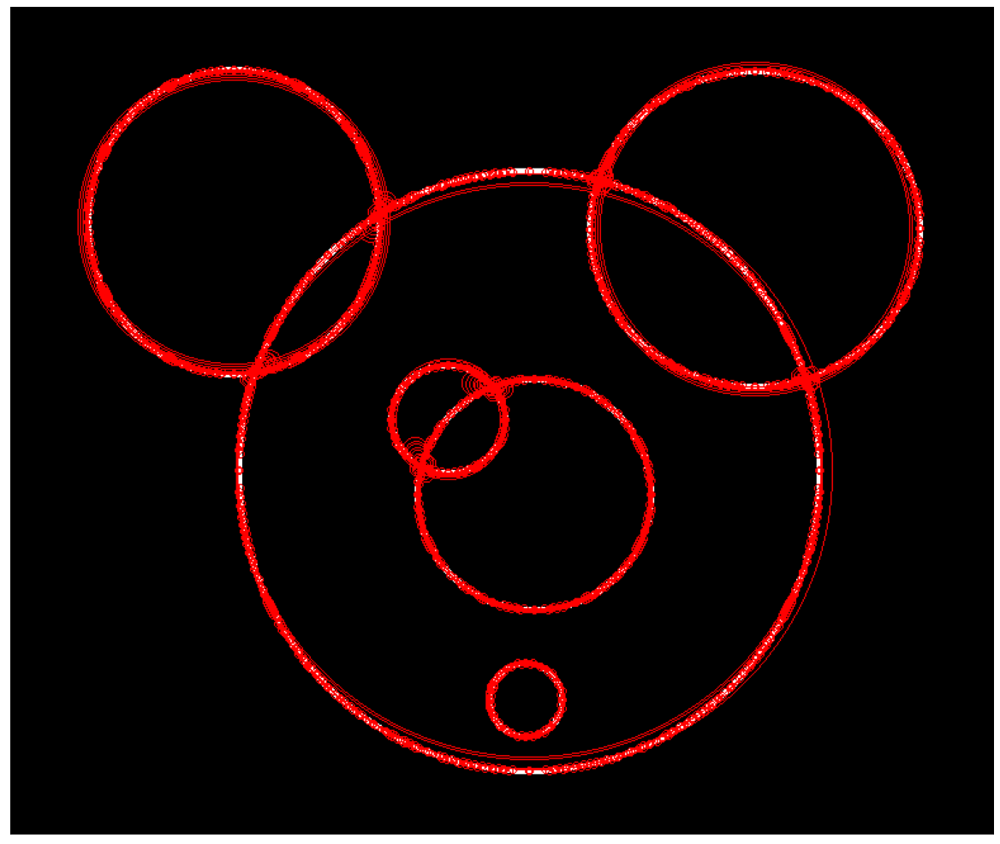

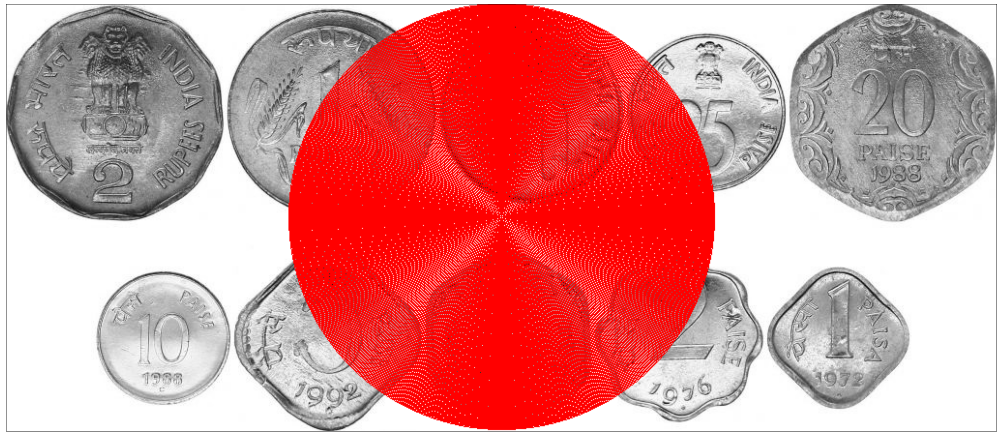

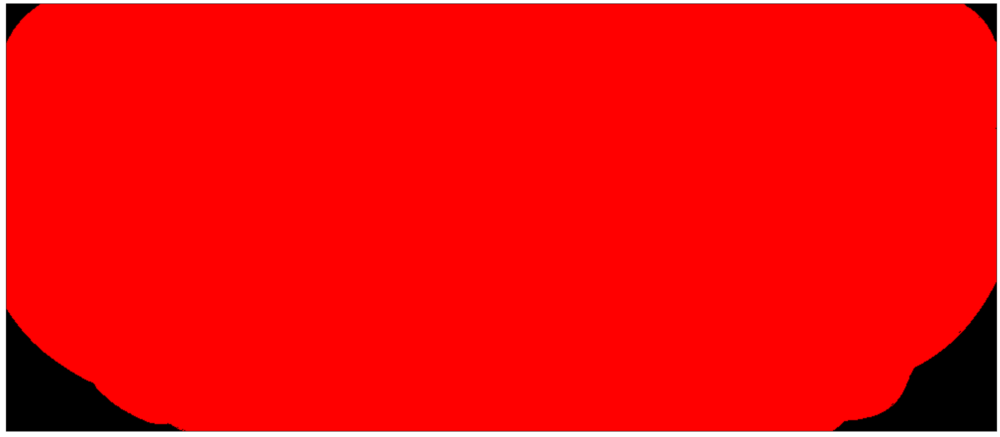

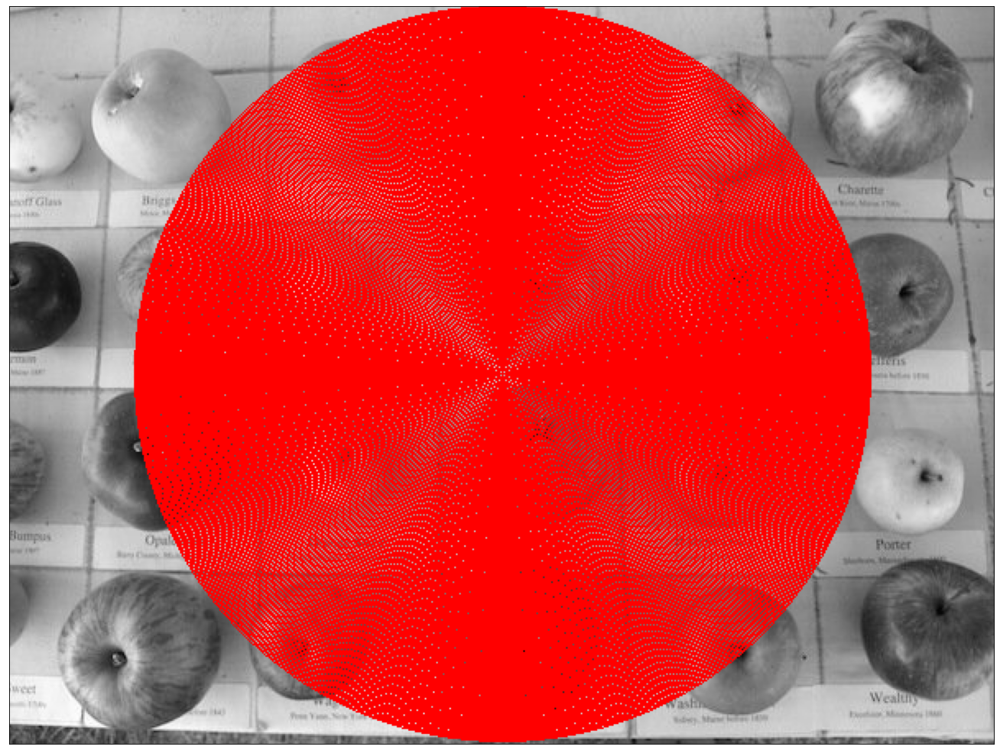

In [5]:
# Поиск окружностей любого радиуса через преобразование Хафа для исходного изображения.
if use_graph:
    circles = []
    for index in range(len(hough_circles)):
        # 5 изображение убрано из-за чудовищно медленной обработки и съедания всех запасов RAM.
        if index > 3:
            break
        hough = hough_circles[index]
        image = cv2.cvtColor(images[index], cv2.COLOR_GRAY2RGB)
        radius = np.arange(0, min(*image.shape[:2]) // 2, 1)
        accums, cx, cy, rad = skimage.transform.hough_circle_peaks(hough, radius, threshold = 0.65 * np.max(hough))
        for center_y, center_x, radius_local in zip(cy, cx, rad):
            circy, circx = skimage.draw.circle_perimeter(center_y, center_x, int(round(radius_local)), shape=image.shape)
            image[circy, circx] = (255, 0, 0)
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(image)
        plt.xticks([]),plt.yticks([])
        plt.show()

Белые окружности на чёрном фоне на 1 изображении распознались множество раз.

Все остальные изображения показали случайные результаты, так как на вход преобразования Хафа нужно подавать бинарное изображение.

In [6]:
radius = np.arange(20, 100, 10) # От 20 до 100 через 1
# Поиск окружностей заданного радиуса через преобразование Хафа для исходного изображения.
if use_graph:
    hough_circles = []
    for image in images:
        print(min(*image.shape))
        circles = skimage.transform.hough_circle(image, radius)
        hough_circles.append(circles)

653
442
432
450
856


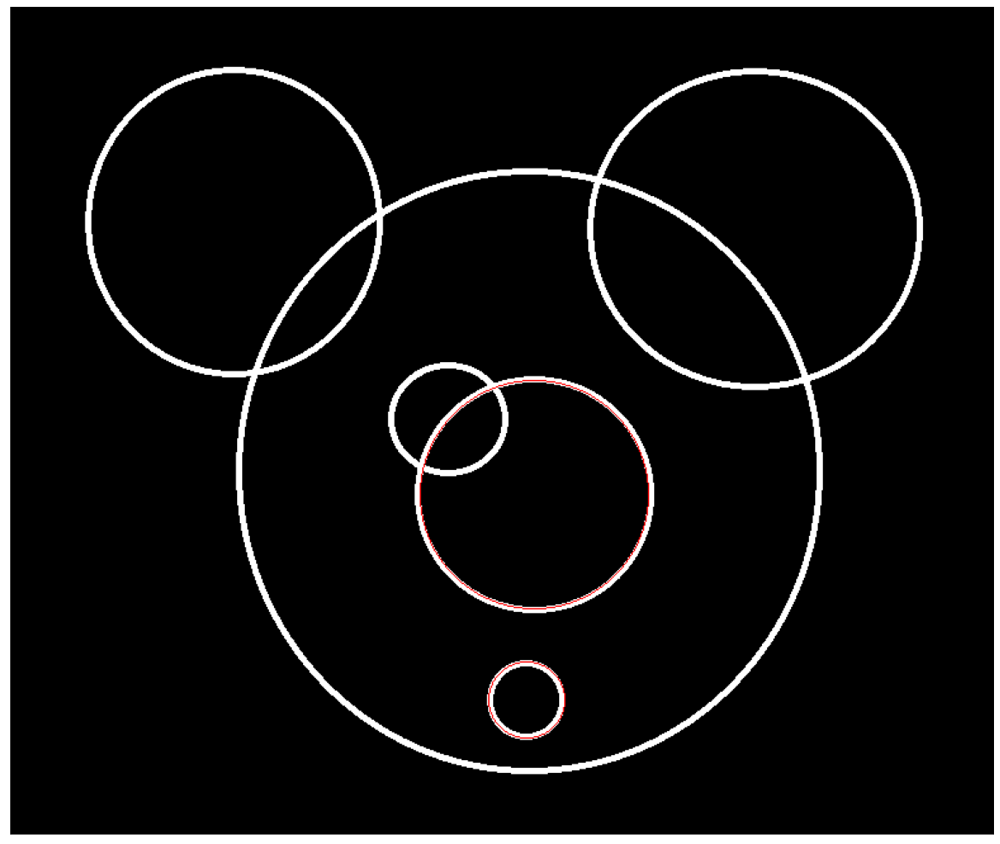

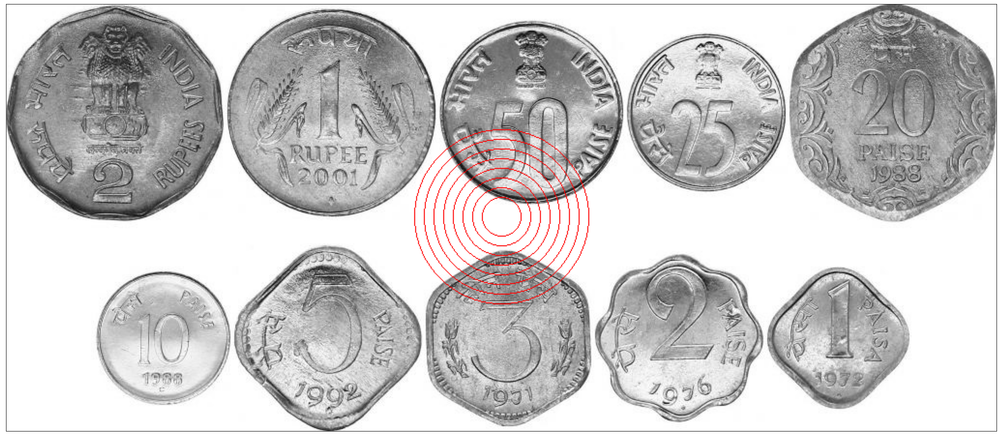

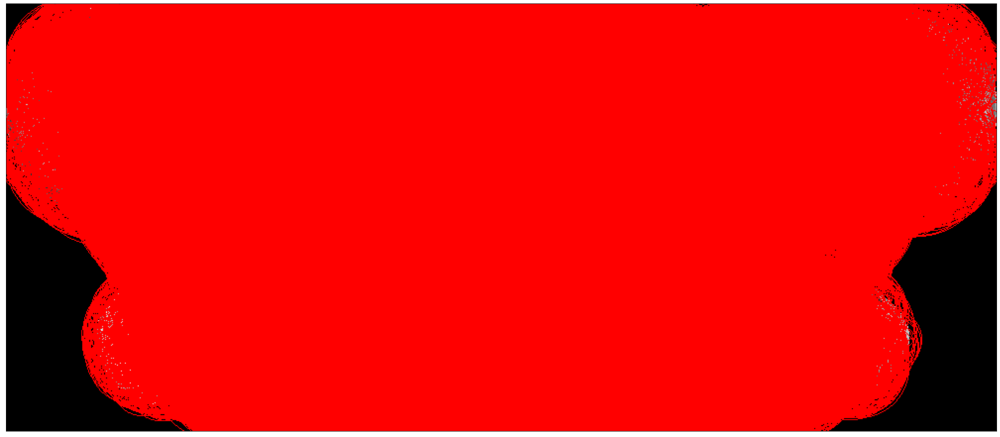

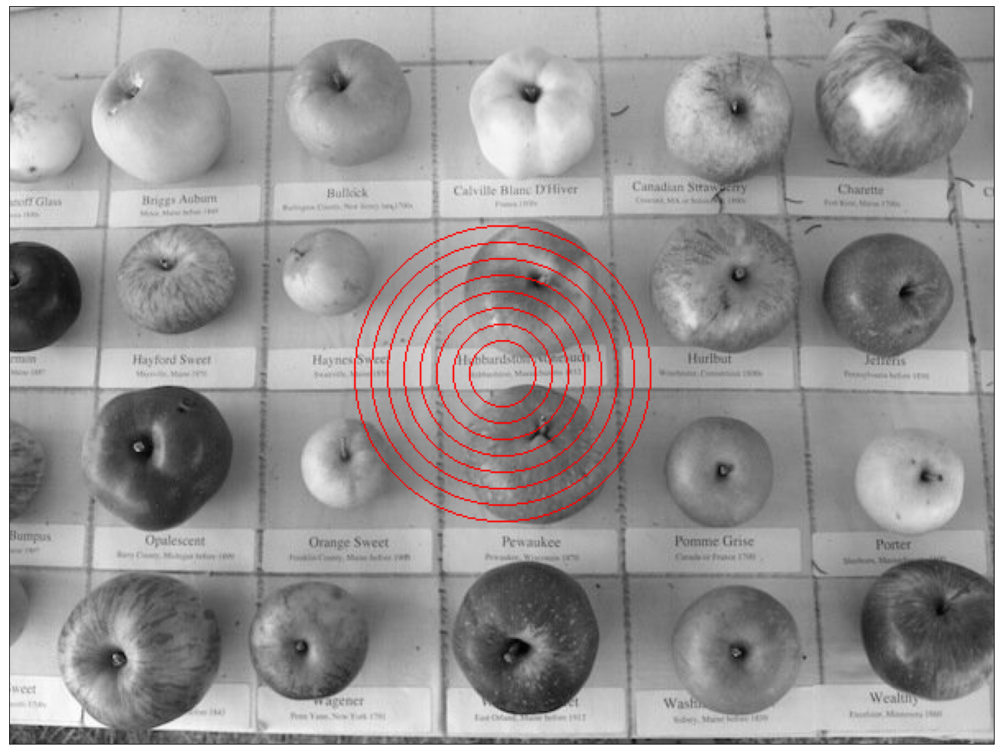

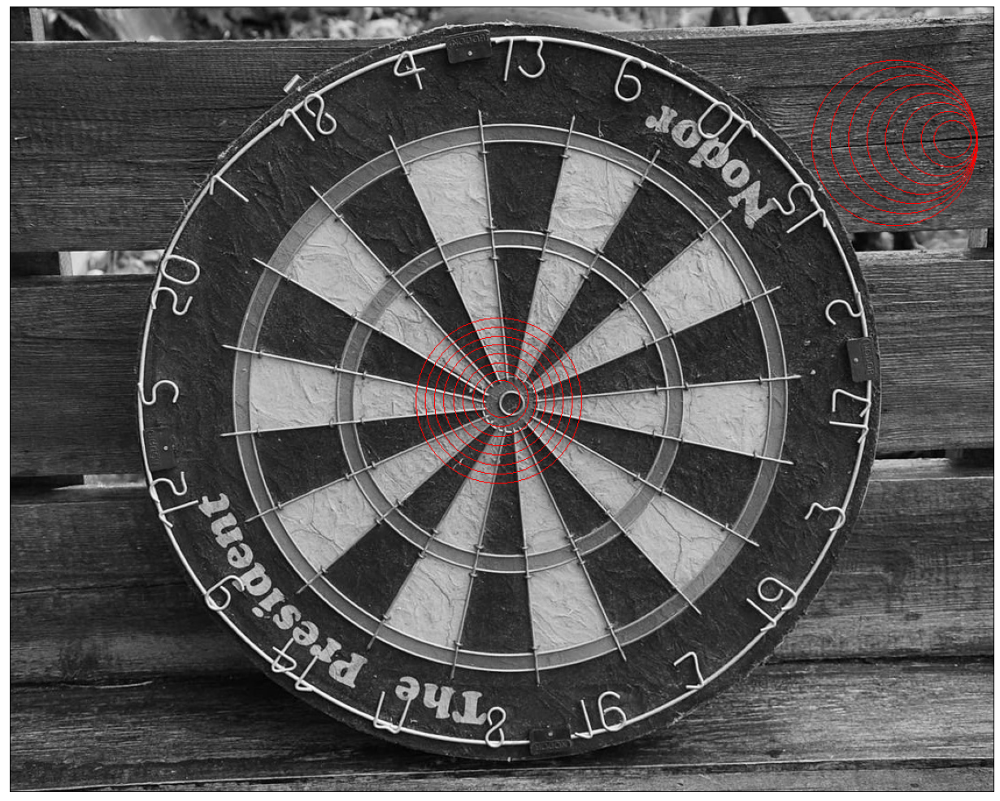

In [7]:
# Поиск окружностей заданного радиуса через преобразование Хафа для исходного изображения.
if use_graph:
    circles = []
    for index in range(len(hough_circles)):
        hough = hough_circles[index]
        image = cv2.cvtColor(images[index], cv2.COLOR_GRAY2RGB)
        accums, cx, cy, rad = skimage.transform.hough_circle_peaks(hough, radius, threshold = 0.65 * np.max(hough))
        for center_y, center_x, radius_local in zip(cy, cx, rad):
            circy, circx = skimage.draw.circle_perimeter(center_y, center_x, int(round(radius_local)), shape=image.shape)
            image[circy, circx] = (255, 0, 0)
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(image)
        plt.xticks([]),plt.yticks([])
        plt.show()

Белые окружности на чёрном фоне на 1 изображении распознались в нужном диапазоне радиусов.

Все остальные изображения показали случайные результаты, так как на вход преобразования Хафа нужно подавать бинарное изображение. Аналогично предыдущему результату.

In [8]:
# Контуры изображений методом Кенни исходных изображений с окружностями
edges = [cv2.Canny(image, 50, 300) for image in images]

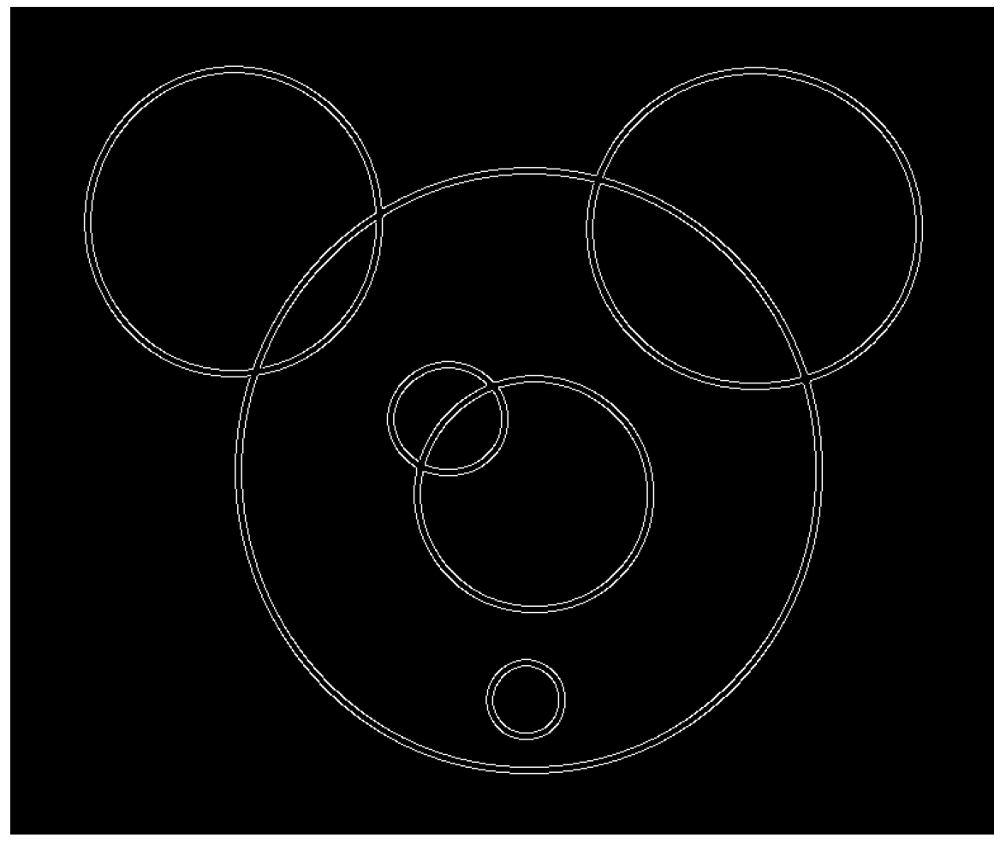

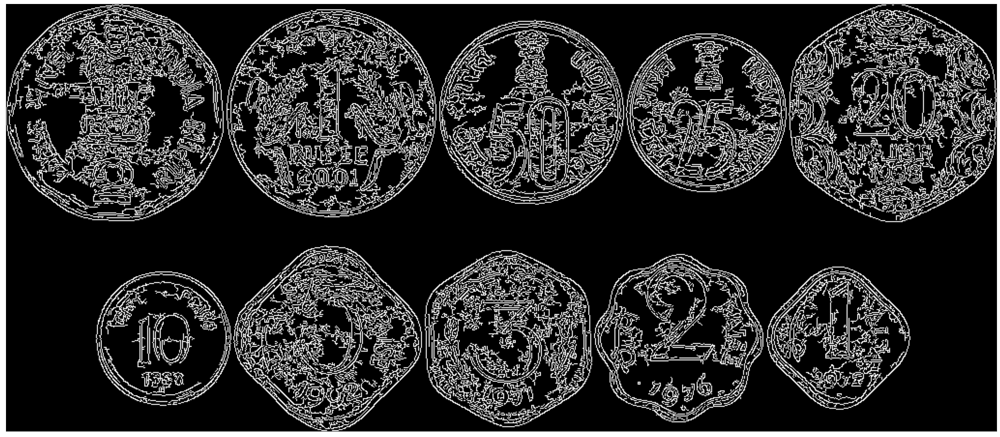

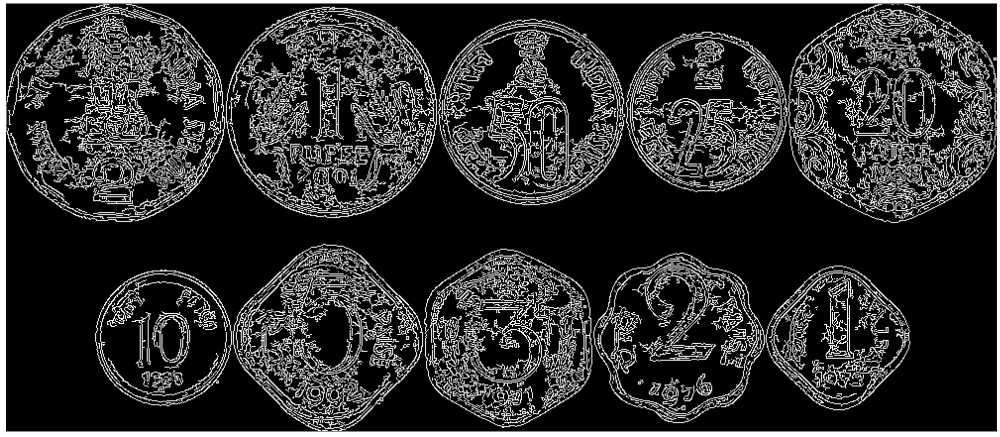

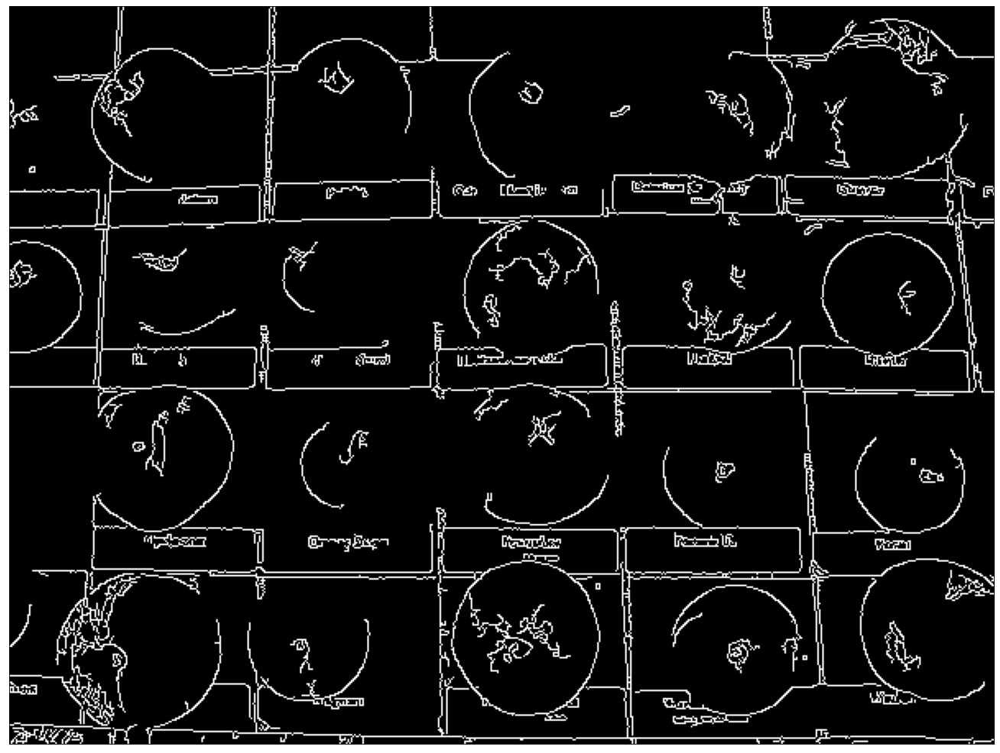

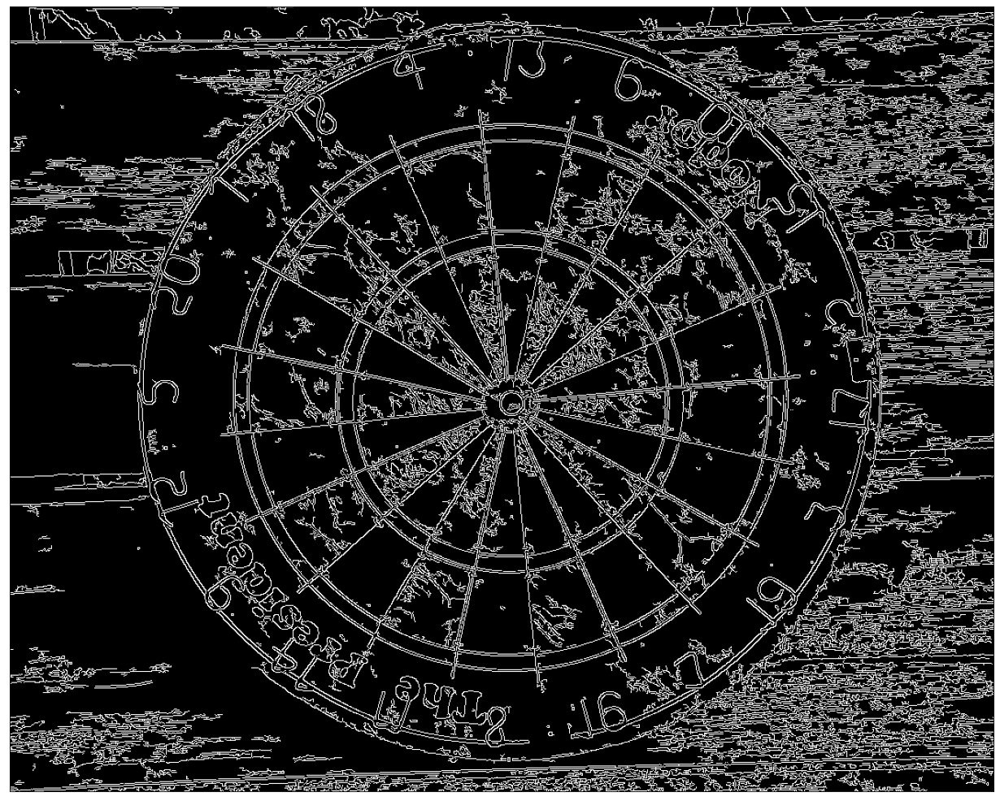

In [9]:
if use_graph:
    for image in edges:
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB))
        plt.xticks([]),plt.yticks([])
        plt.show()

In [21]:
# Поиск окружностей любого радиуса от 20 через преобразование Хафа для контуров изображения.
if use_graph:
    hough_circles = []
    for image in edges:
        print(min(*image.shape))
        radius = np.arange(20, min(*image.shape) // 2, 1)
        circles = skimage.transform.hough_circle(image, radius)
        hough_circles.append(circles)

653
442
432
450
856


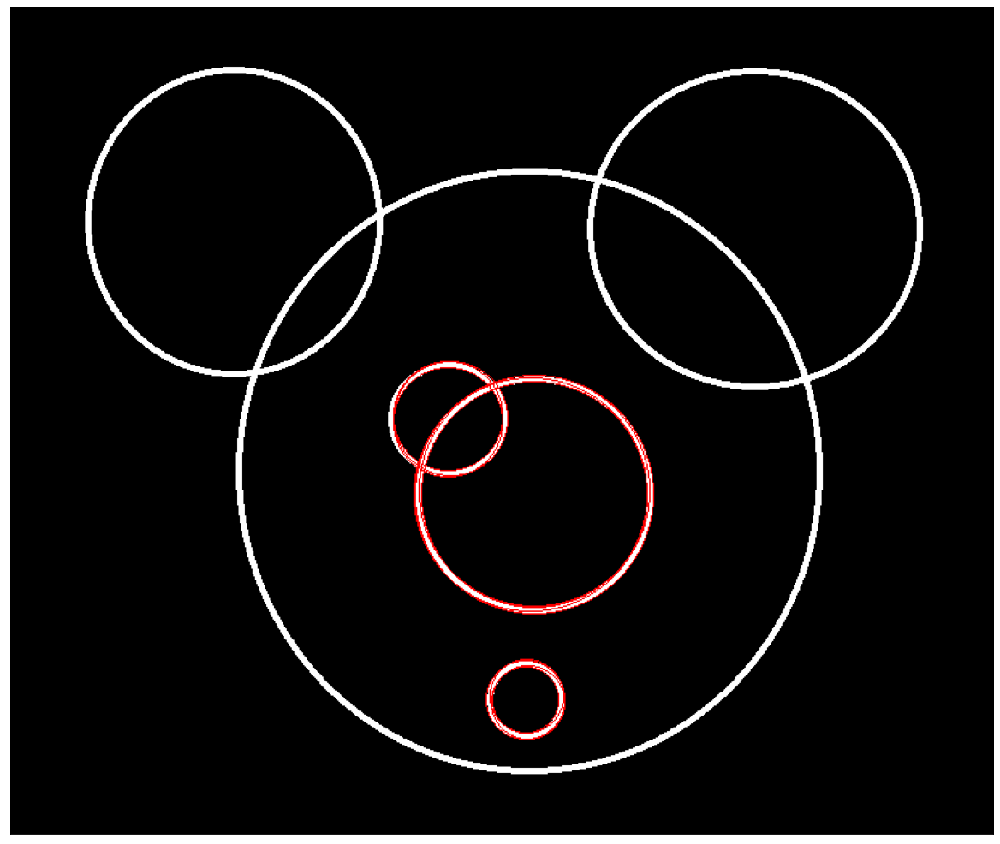

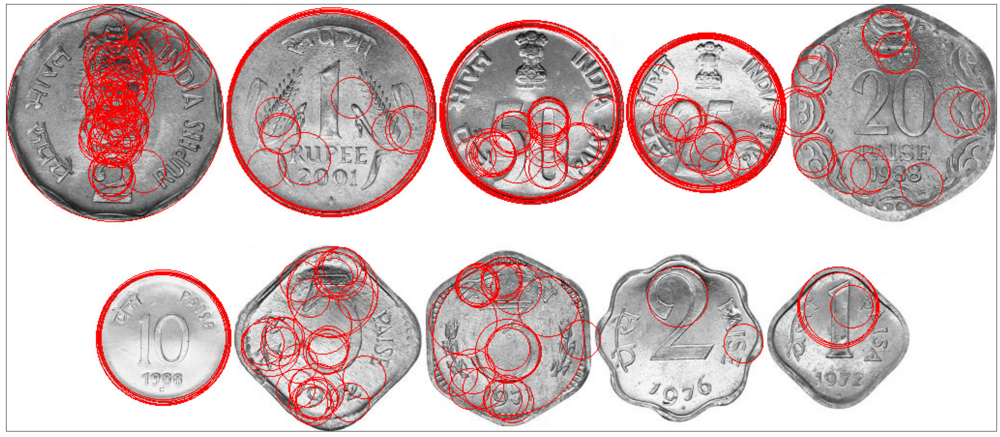

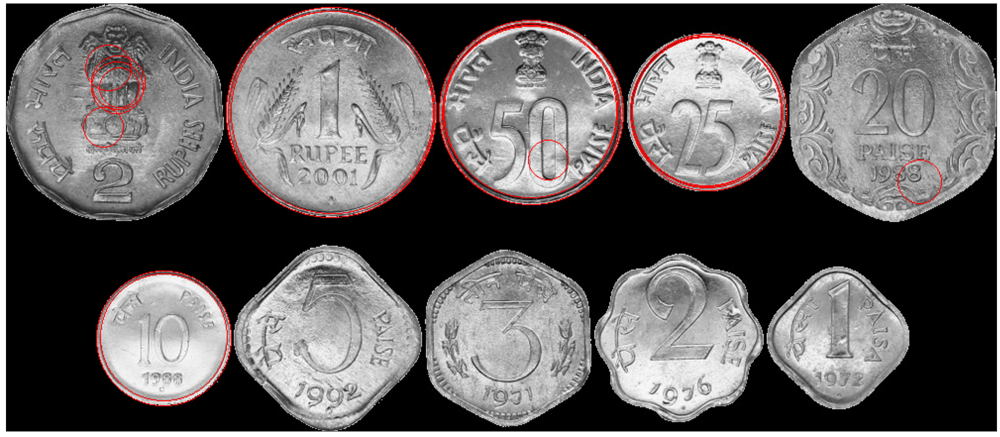

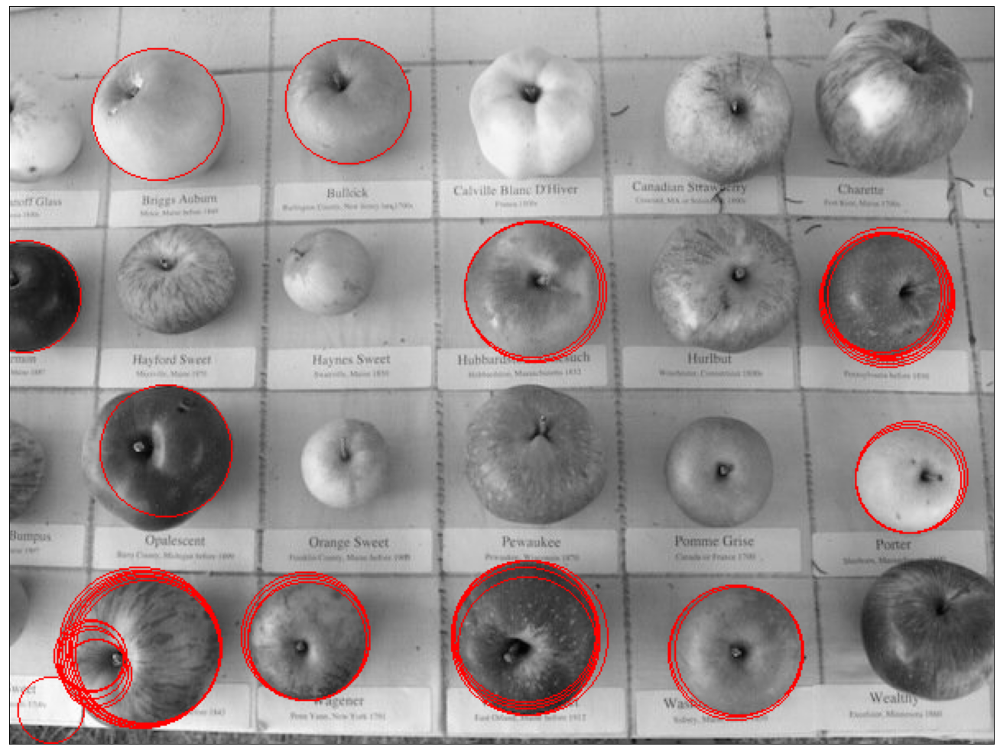

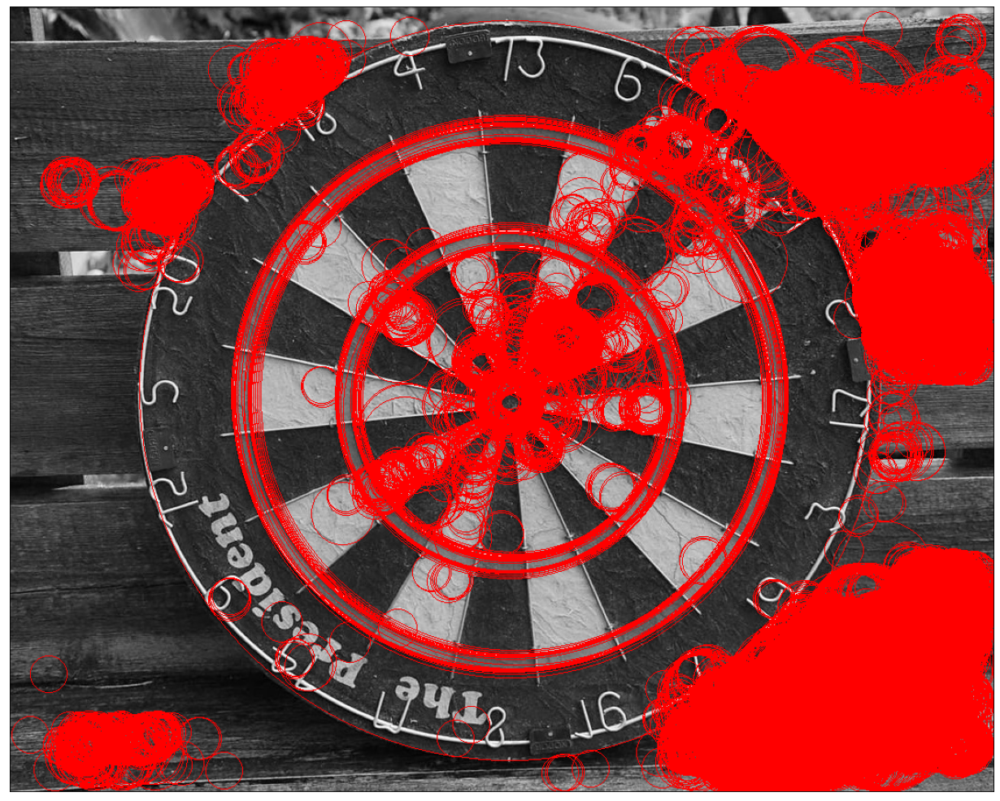

In [26]:
# Поиск окружностей любого радиуса от 20 через преобразование Хафа для контуров изображения.
if use_graph:
    circles = []
    for index in range(len(hough_circles)):
        hough = hough_circles[index]
        image = cv2.cvtColor(images[index], cv2.COLOR_GRAY2RGB)
        radius = np.arange(20, min(*image.shape[:2]) // 2, 1)
        accums, cx, cy, rad = skimage.transform.hough_circle_peaks(hough, radius, threshold = 0.65 * np.max(hough))
        for center_y, center_x, radius_local in zip(cy, cx, rad):
            circy, circx = skimage.draw.circle_perimeter(center_y, center_x, int(round(radius_local)), shape=image.shape)
            image[circy, circx] = (255, 0, 0)
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(image)
        plt.xticks([]),plt.yticks([])
        plt.show()

Алгоритм работает всё ещё Адски долго, но теперь выдаёт относительно адекватные результаты. Присутствует много шумов, как не изменяй значение threshold, а окружности распознаяются множество раз.

In [28]:
radius = np.arange(50, 400, 1) # От 50 до 400
# Поиск окружностей заданного радиуса через преобразование Хафа для контуров изображения.
if use_graph:
    hough_circles = []
    for image in edges:
        print(min(*image.shape))
        circles = skimage.transform.hough_circle(image, radius)
        hough_circles.append(circles)

653
442
432
450
856


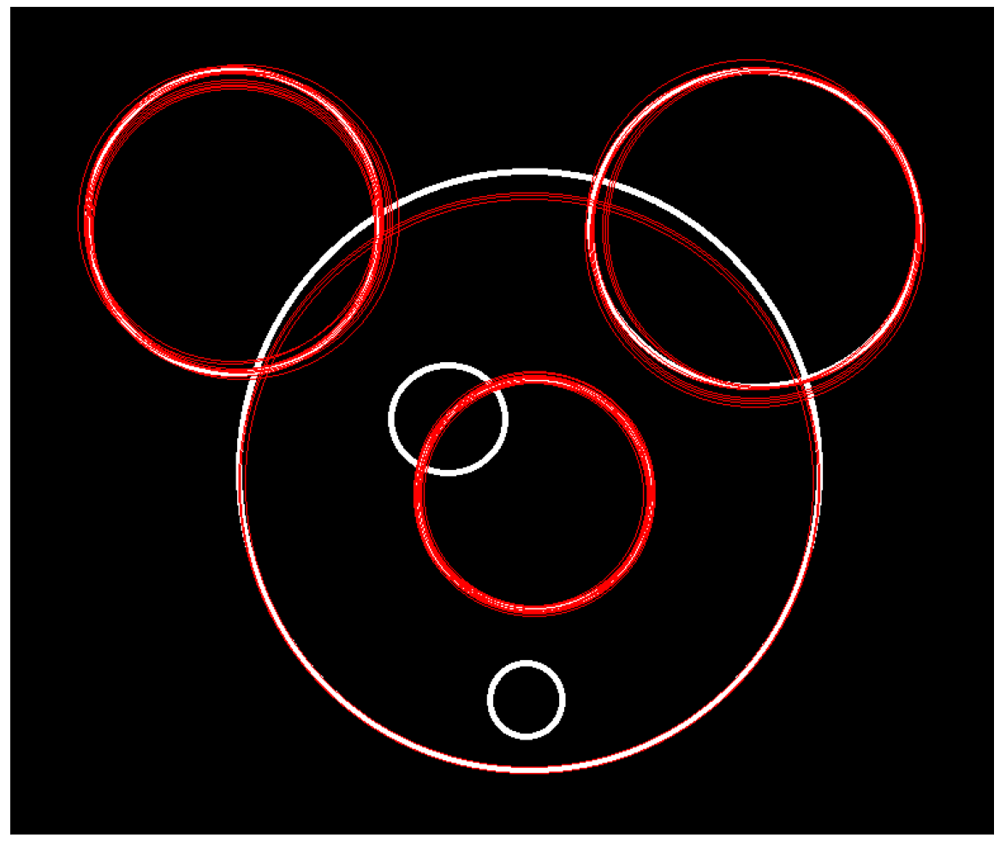

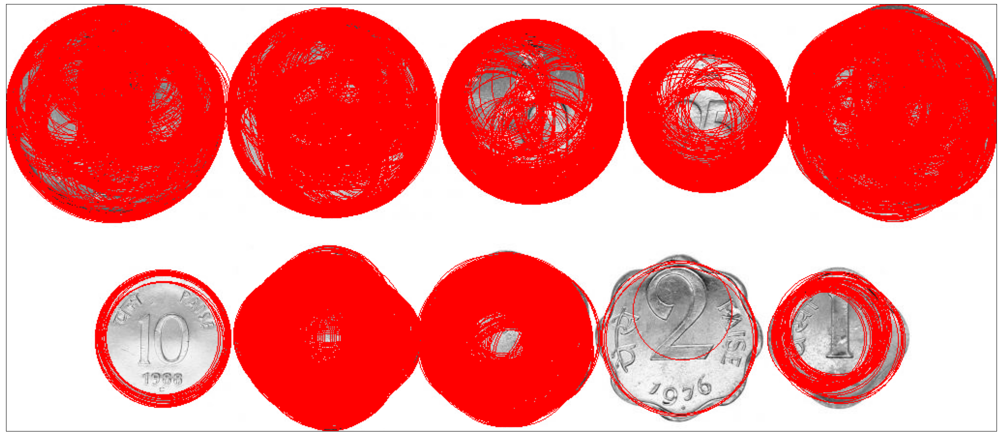

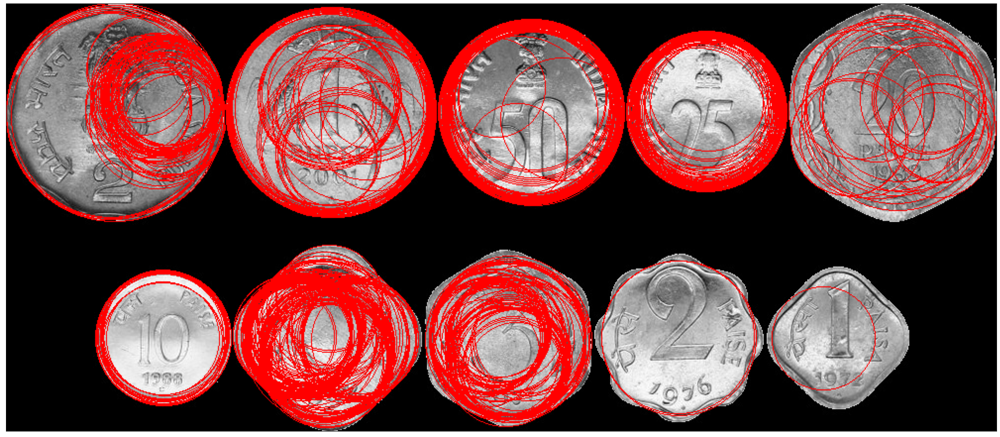

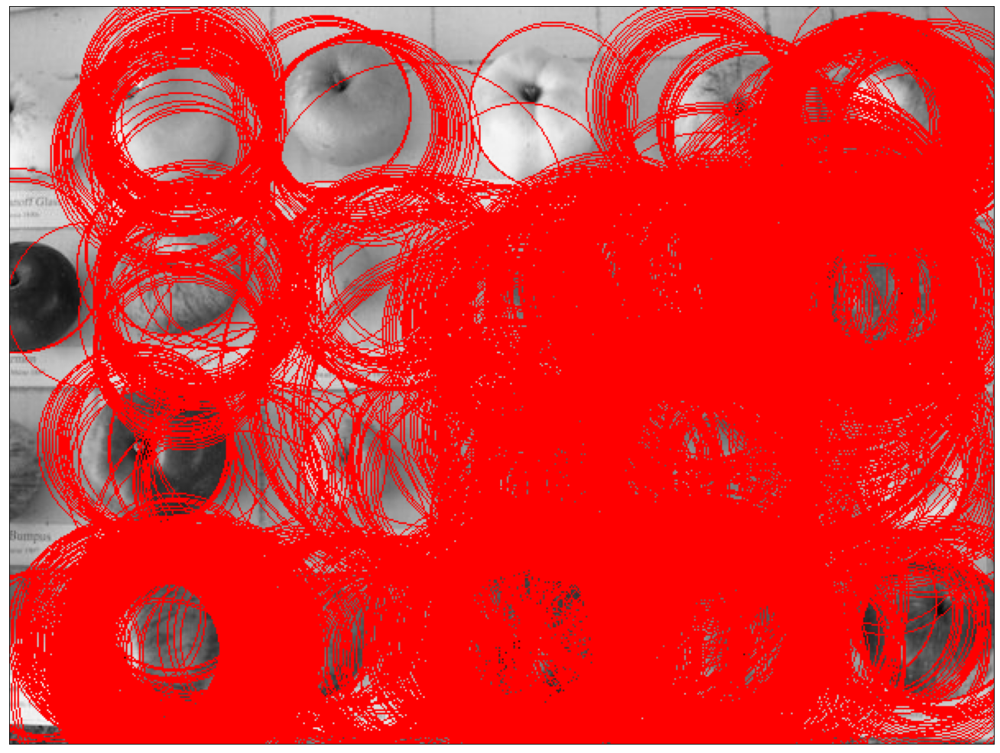

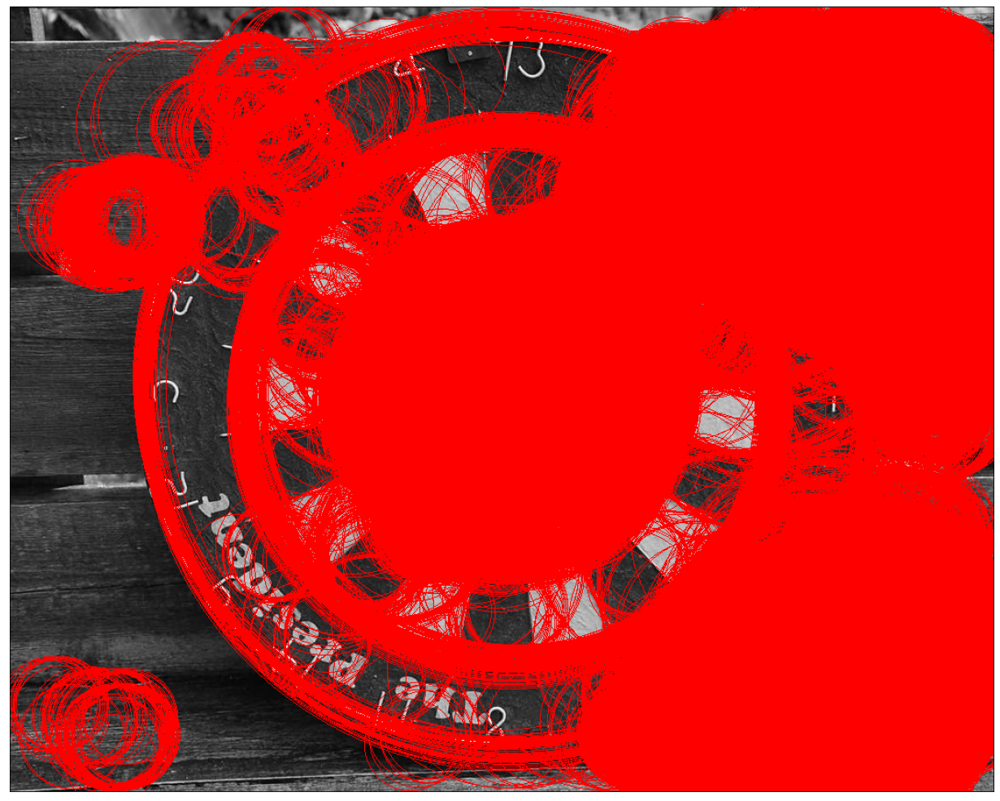

In [30]:
# Поиск окружностей заданного радиуса через преобразование Хафа для контуров изображения.
if use_graph:
    circles = []
    for index in range(len(hough_circles)):
        hough = hough_circles[index]
        image = cv2.cvtColor(images[index], cv2.COLOR_GRAY2RGB)
        accums, cx, cy, rad = skimage.transform.hough_circle_peaks(hough, radius, threshold = 0.5 * np.max(hough))
        for center_y, center_x, radius_local in zip(cy, cx, rad):
            circy, circx = skimage.draw.circle_perimeter(center_y, center_x, int(round(radius_local)), shape=image.shape)
            image[circy, circx] = (255, 0, 0)
        figure(figsize=(32, 16), dpi=80)
        plt.imshow(image)
        plt.xticks([]),plt.yticks([])
        plt.show()

Если выбрать радиус от 50 до 400 распознаются только самые большие окружности, и шумов будет меньше, но результат всё равно не удовлетворителен из-за колоссального дублирования. В skimage нет возможности отфильтровать центры по дистанции между собой, зато в OpenCV есть.